# Proyecto final
## Procesamiento Digital de Señales
### Johan Fernando Mora Ramirez
### cc:1007847722
### 2023-1

## 1. Analisis en frecuencia y diseño de filtros. En un sistema de comunicaciones se transmite una señal de audio, esta, debido a los efectos del canal llega al receptor con un cierto ruido, se le otorga a usted la tarea de recuperar la señal mediante el uso de filtros FIR.

In [1]:
from scipy.io.wavfile import read  #libreria para la lectura de audios
from IPython.display import Audio  #para escuchar la señal
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.pylab import *
import scipy.signal as signal
from scipy.fft import fft, fftfreq
%matplotlib inline
from scipy.signal import kaiserord, lfilter, firwin, freqz

### a. Cargar el archivo de audio "ParaElisa.wav", dicho audio es la señal que originalmente se transmitio por el canal. Graficar en el tiempo y su espectro de frecuencias para analizar así su comportamiento.

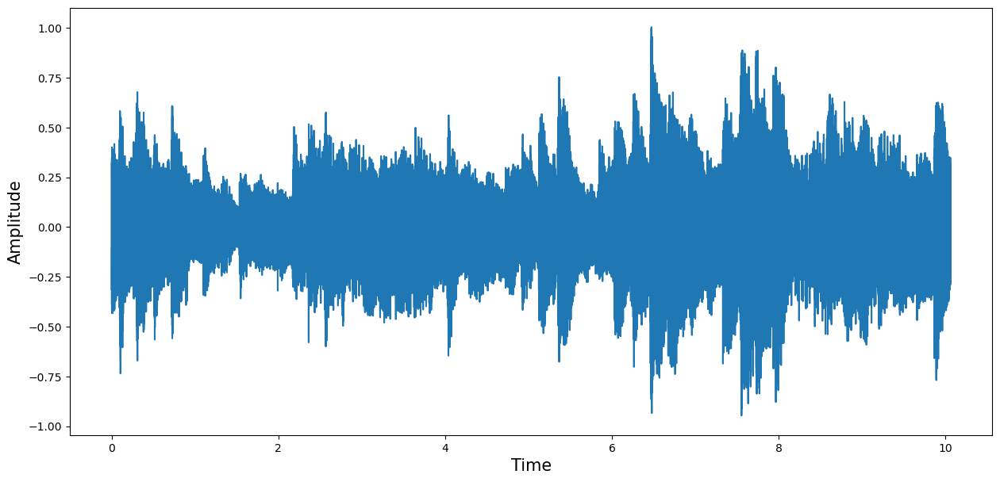

In [2]:
file_audio=('ParaElisa.wav')
fs, x=read(file_audio)
fs=2*fs
x_flat = np.frombuffer(x, dtype=np.int16)
x_flat=x_flat/float(max(abs(x_flat)))
t=np.arange(0,float(len(x_flat))/fs, 1/fs)
x_flat=x_flat-np.mean(x_flat)

plt.figure(figsize=(15,7))
plt.plot(t,x_flat)  #graficacion
plt.xlabel('Time',fontsize=15)
plt.ylabel('Amplitude',fontsize=15)
plt.show()
Audio(x_flat,rate=fs)

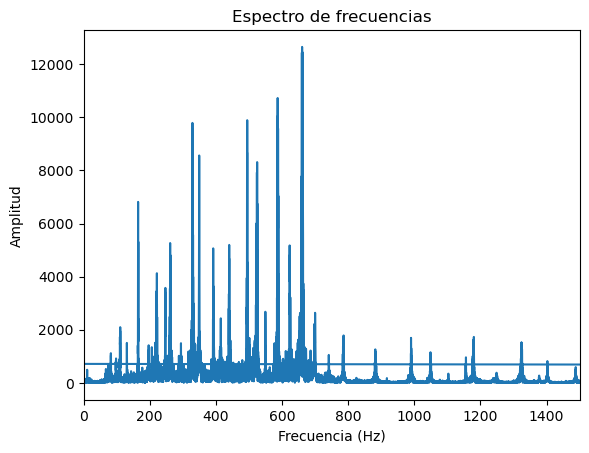

In [3]:
fmin=0
fmax=1500
# Cálculo de la transformada de Fourier
transformada = fft(x_flat)
frecuencias = fftfreq(len(x_flat), 1 / fs)

# Graficar el espectro de frecuencias
plt.plot(frecuencias, np.abs(transformada))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de frecuencias')

plt.xlim(fmin, fmax)
plt.show()

### b. Agregue el ruido a la señal, este estará representado con señales senoidales cuyas frecuencias son 100Hz y 1000Hz, analice su espectro, ¿en que se diferencia con el espectro anterior?¿Es posible identificar las señales agregadas en el espectro de frecuencias?

In [4]:
import numpy as np
import matplotlib.pyplot as plt

fr1 = 1000  # Frecuencia del ruido en Hz
fr2 = 100

r1=np.sin(2*np.pi*fr1*t)
r2=np.sin(2*np.pi*fr2*t)
R=r1+r2
SRuido=x_flat+R

Audio(SRuido,rate=fs)  #para escuchar la señal si se desea

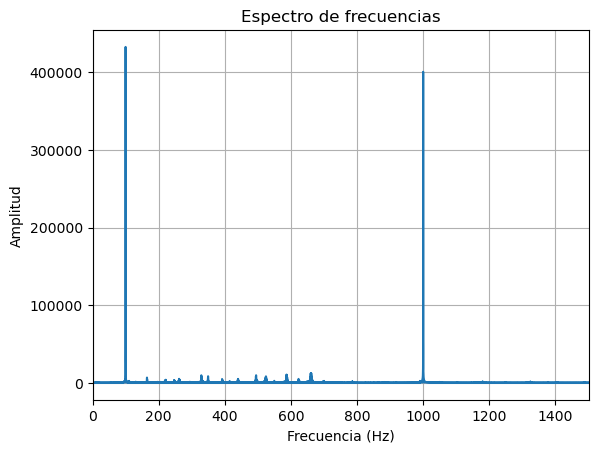

In [5]:
fmin=0
fmax=1500
# Cálculo de la transformada de Fourier
transformada = fft(SRuido)
frecuencias = fftfreq(len(SRuido), 1 / fs)

# Graficar el espectro de frecuencias
plt.plot(frecuencias, np.abs(transformada))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de frecuencias')
plt.grid(True)
plt.xlim(fmin, fmax)
plt.show()

##### En comparación con el espectro anterior, se puede apreciar un cambio notorio, ya que aoarecen un par de picos en las frecuencias 100Hz y 1000Hz correspondientes al ruido adicionado y que precisamente representan dichas señales.

### c. Diseñe un sistema de filtros FIR con el metodo enventanado que permita recuperar la señal original, justifique los parámetros de los filtros diseñados,realice el mismo procedimiento con 2 ventanas diferentes, solo se permite el uso de filtros pasa bajas y pasa altas para completar esta labor

##### Para realizar esta labor es necesario el uso de un filtro pasabandas, no obstate debido a las limitaciones impuestas se usarán un filtro pasa bajas y uno pasa altas en cascada, el primer análisis se realizará con un enventanado Hamming.

In [6]:
def choose_windows(name, N):
    # Rect/Hanning/Hamming
    if name == 'Hamming':
        window = np.array([0.54 - 0.46 * np.cos(2 * np.pi * n / (N - 1)) for n in range(N)])
    elif name == 'Hanning':
        window = np.array([0.5 - 0.5 * np.cos(2 * np.pi * n / (N - 1)) for n in range(N)])
    elif name == 'Rect':
        window = np.ones(N)
    elif name == 'black':
        window = np.array([0.42-0.5*np.cos((2*np.pi*n)/(N-1))+0.08*np.cos((4*np.pi*n)/(N-1))for n in range(N)])
    return window

Orden del filtro:  3529.0


(0.0, 1500.0, -0.048682143485726685, 1.0508173863326125)

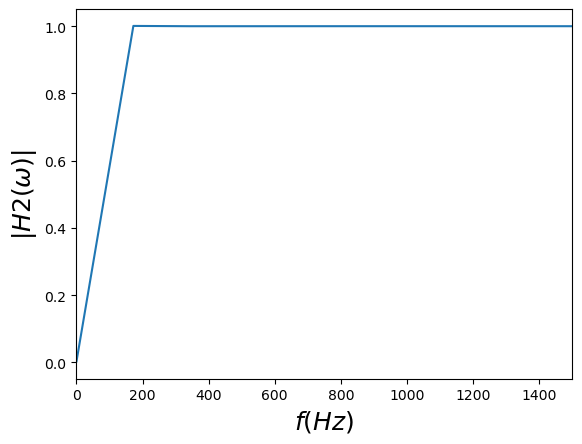

In [7]:
fc=150/fs
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=100 # Ancho de banda en la banda de transicion
wc = 2*np.pi*fc # frecuencia de corte normalizada en radianes
bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes

M=4*fs/BW + 1 # orden estimado del filtro Ventana Hamming

print('Orden del filtro: ', M)
n = np.arange(-M,M)

h1 = -2*fc*np.sinc((wc*n)/np.pi) # Respuesta del filtro ideal 
h1[n==0]=1-2*fc # cuando es pasa altas
w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal
win2 = choose_windows(name='Hamming', N=len(n))
h2=h1*win2 # Multiplico la respuesta ideal por la ventana
A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

plt.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.axis(xmax=1500,xmin=0)

In [8]:
y = lfilter(h2, 1,SRuido )

Orden del filtro:  3529.0


(0.0, 1500.0, -0.050051109498406236, 1.0510786594462416)

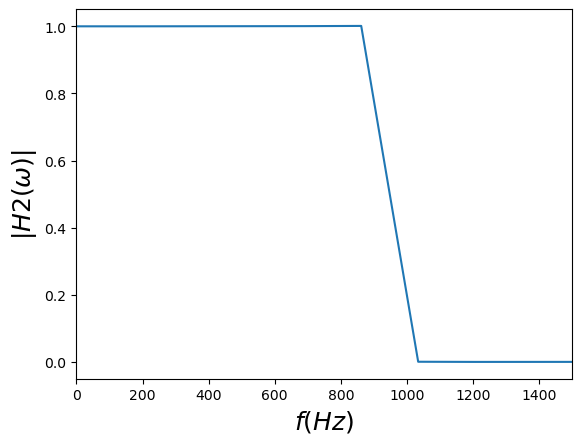

In [9]:
fc=950/fs
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=100 # Ancho de banda en la banda de transicion
wc = 2*np.pi*fc # frecuencia de corte normalizada en radianes
bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes
M=4*fs/BW +1 # orden estimado del filtro
print('Orden del filtro: ', M)
n = np.arange(-M,M)

h1 = 2*fc*np.sinc((wc*n)/np.pi) # Respuesta del filtro ideal 
h1[n==0]=2*fc # cuando es pasa bajas
w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal
win2 = choose_windows(name='Hamming', N=len(n))
h2=h1*win2 # Multiplico la respuesta ideal por la ventana
A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

plt.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.axis(xmax=1500,xmin=0) #para escuchar la señal si se desea

In [10]:
SRec = lfilter(h2, 1,y )

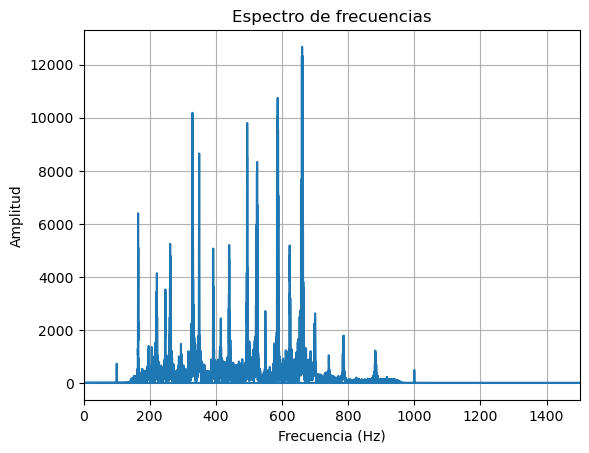

In [11]:
fmin=0
fmax=1500
# Cálculo de la transformada de Fourier
transformada = fft(SRec)
frecuencias = fftfreq(len(SRec), 1 / fs)

# Graficar el espectro de frecuencias
plt.plot(frecuencias, np.abs(transformada))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de frecuencias')
plt.grid(True)
plt.xlim(fmin, fmax)
plt.show()

In [12]:
Audio(SRec,rate=fs)  #para escuchar la señal si se desea

Orden del filtro:  883.0


(0.0, 1500.0, -0.04910338401574108, 1.0502382660901561)

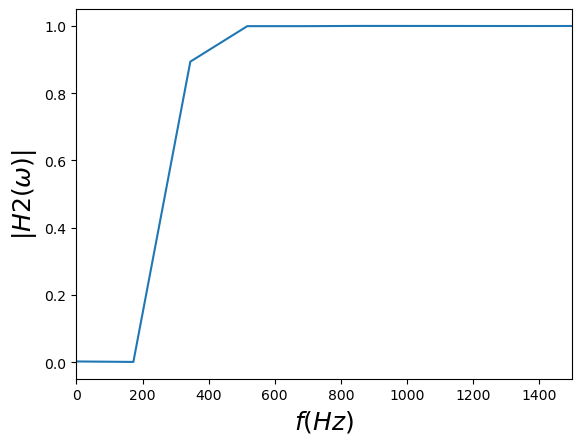

In [13]:
fc=300/fs
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=400 # Ancho de banda en la banda de transicion
wc = 2*np.pi*fc # frecuencia de corte normalizada en radianes
bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes
M=4*fs/BW+1 # orden estimado del filtro
print('Orden del filtro: ', M)
n = np.arange(-M,M)

h1 = -2*fc*np.sinc((wc*n)/np.pi) # Respuesta del filtro ideal 
h1[n==0]=1-2*fc # cuando es rechazabanda
w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal
win2 = choose_windows(name='Hamming', N=len(n))
h2=h1*win2 # Multiplico la respuesta ideal por la ventana
A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

plt.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.axis(xmax=1500,xmin=0)

In [14]:
y2 = lfilter(h2, 1,SRuido )

Orden del filtro:  883.0


(0.0, 1500.0, -0.050060006540924545, 1.0512781713607244)

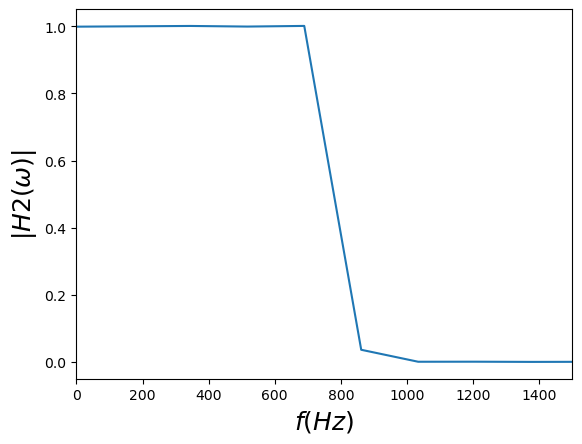

In [15]:
fc=800/fs
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=400 # Ancho de banda en la banda de transicion
wc = 2*np.pi*fc # frecuencia de corte normalizada en radianes
bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes
M=4*fs/BW +1 # orden estimado del filtro
print('Orden del filtro: ', M)
n = np.arange(-M,M)

h1 = 2*fc*np.sinc((wc*n)/np.pi) # Respuesta del filtro ideal 
h1[n==0]=2*fc # cuando es rechazabanda
w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal
win2 = choose_windows(name='Hamming', N=len(n))
h2=h1*win2 # Multiplico la respuesta ideal por la ventana
A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

plt.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.axis(xmax=1500,xmin=0)

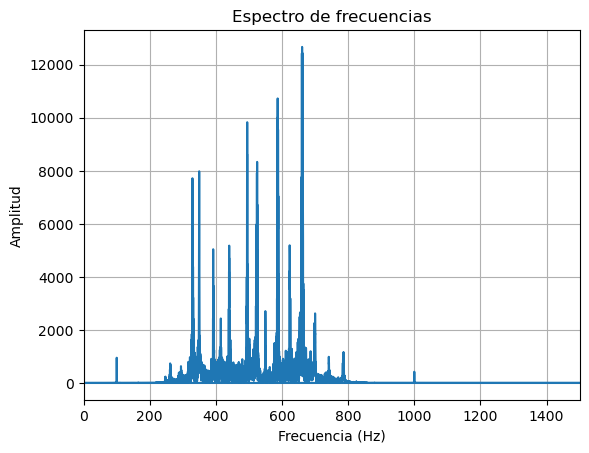

In [16]:
SRec2 = lfilter(h2, 1,y2 )
fmin=0
fmax=1500
# Cálculo de la transformada de Fourier
transformada = fft(SRec2)
frecuencias = fftfreq(len(SRec2), 1 / fs)

# Graficar el espectro de frecuencias
plt.plot(frecuencias, np.abs(transformada))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de frecuencias')
plt.grid(True)
plt.xlim(fmin, fmax)
plt.show()

In [17]:
Audio(SRec2,rate=fs)  #para escuchar la señal si se desea

Se utilizó un filtro FIR con enventanado Hamming, con el objetivo de ser mas precisos inicialmente se utilizaron filtros con un Roll-off de 100Hz, y unas frecuencias de corte de 150Hz y 950Hz, de esta manera se atenuó completamente el ruido y se conservó una calidad considerable en el audio transmitido, no obstante el precio de de dicha presición se traduce a un costo computacional elevado, pues en este caso los filtros serían de orden 3529, así mismo, se realizó el mismo análisis con un roll-off de 400Hz para este caso las frecuencias de corte fueron de 300Hz y 800Hz, el orden de los filtros en consecuencia fué de 883 y pese a que la calidad del sonido disminuyó, se sigue conservvando cierta fidelidad a la señal transmitida.

Orden del filtro:  1765.0


(0.0, 1500.0, -0.0325012670164555, 1.0534202069516294)

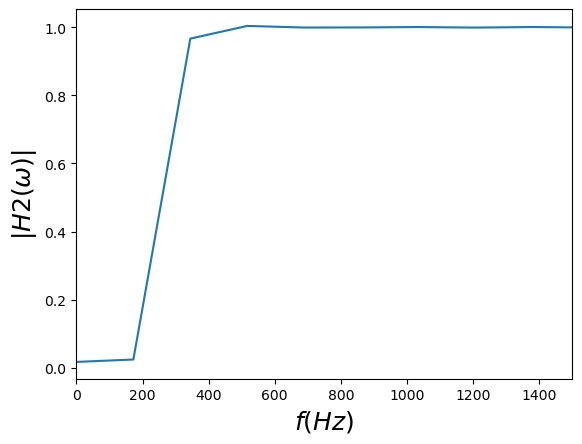

In [18]:
fc=300/fs
Adb=0
N = 512
BW=100
wc = 2*np.pi*fc
bwn=2*np.pi*BW/fs

M=2*fs/BW + 1

print('Orden del filtro: ', M)
n = np.arange(-M,M)

h1 = -2*fc*np.sinc((wc*n)/np.pi) # Respuesta del filtro ideal 
h1[n==0]=1-2*fc # cuando es pasa altas
w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal
win2 = choose_windows(name='Rect', N=len(n))
h2=h1*win2 # Multiplico la respuesta ideal por la ventana
A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

plt.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.axis(xmax=1500,xmin=0)

In [19]:
y2 = lfilter(h2, 1,SRuido )

Orden del filtro:  1765.0


(0.0, 1500.0, -0.05030708766820868, 1.0565616814506062)

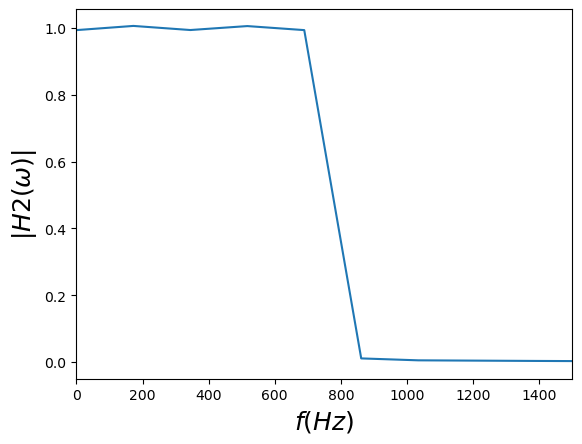

In [20]:
fc=800/fs
Adb=0 # Ganancia del filtro en decibeles
N = 512 # Numero de puntos de la FFT
BW=100 # Ancho de banda en la banda de transicion
wc = 2*np.pi*fc # frecuencia de corte normalizada en radianes
bwn=2*np.pi*BW/fs # ancho de banda  normalizado en radianes
M=2*fs/BW +1 # orden estimado del filtro
print('Orden del filtro: ', M)
n = np.arange(-M,M)

h1 = 2*fc*np.sinc((wc*n)/np.pi) # Respuesta del filtro ideal 
h1[n==0]=2*fc # cuando es rechazabanda
w1,Hh1 = signal.freqz(h1,1,whole=True, worN=N) # Respuesta en frecuencia del filtro ideal
win2 = choose_windows(name='Rect', N=len(n))
h2=h1*win2 # Multiplico la respuesta ideal por la ventana
A=np.sqrt(10**(0.1*Adb))
h2=h2*A # Ganancia del filtro
w2,Hh2 = signal.freqz(h2,1,whole=True, worN=N) # Respuesta en frecuencia del filtro enventanado

plt.plot((w2-np.pi)*fs/(2*np.pi),np.abs(np.fft.fftshift(Hh2)))
plt.axis(xmax=fs/2,xmin=-fs/2)
plt.xlabel(r"$f (Hz)$",fontsize=18)
plt.ylabel(r"$|H2(\omega)| $",fontsize=18)
plt.axis(xmax=1500,xmin=0)

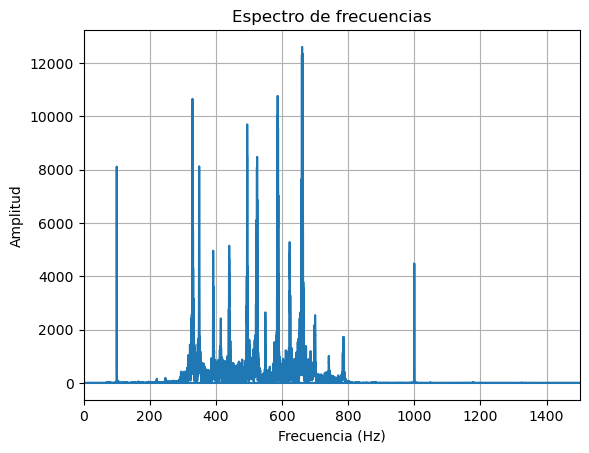

In [21]:
SRec3 = lfilter(h2, 1,y2 )
fmin=0
fmax=1500
# Cálculo de la transformada de Fourier
transformada = fft(SRec3)
frecuencias = fftfreq(len(SRec3), 1 / fs)

# Graficar el espectro de frecuencias
plt.plot(frecuencias, np.abs(transformada))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Amplitud')
plt.title('Espectro de frecuencias')
plt.grid(True)
plt.xlim(fmin, fmax)
plt.show()

In [22]:
Audio(SRec3,rate=fs)  

Aplicando un enventandao Rectangular, el resultado obtenido es una señal con un ruido algo atenuado, no obstante no fue poible atenuar por completo estas frecuencias.

## 2. Aplicaciones de filtros FIR.

#### a. Cargar los archivos de audio "Agudo.wav" y "Grave.wav", graficar yescuchar ambos audios. ¿que puede deducir al respecto de los tipos de voces de los audios? ¿En que rango de frecuencias cree que se puede encontrar cada uno?

C:\Users\JOHAN MORA\AppData\Local\Temp\ipykernel_6412\1807853143.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fsA, xA=read(file_audioA)  #Cargar el archivo


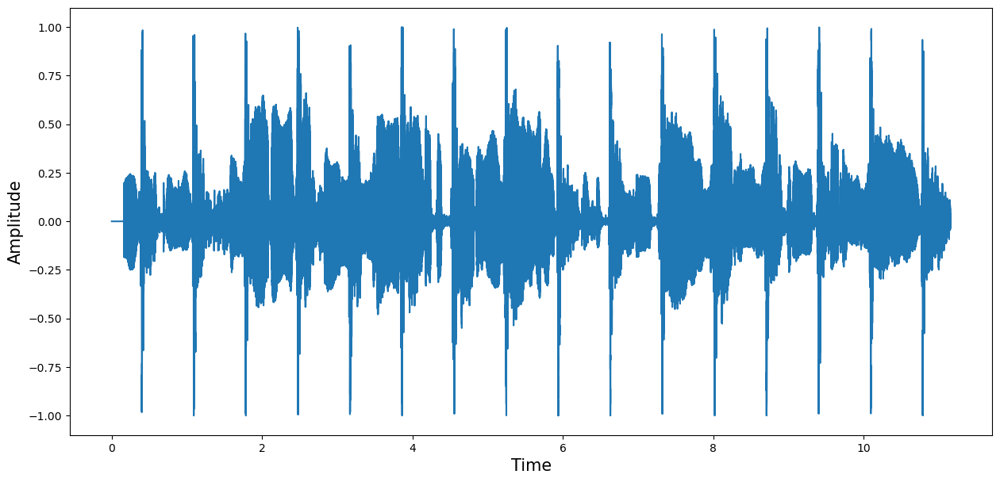

In [23]:
file_audioA=('Agudo.wav') #Ruta del archivo con la señal
fsA, xA=read(file_audioA)  #Cargar el archivo
fsA=2*fsA
x_flatA = np.frombuffer(xA, dtype=np.int16)
x_flatA=x_flatA/float(max(abs(x_flatA)))  #Escala de amplitud de la señal
t=np.arange(0,float(len(x_flatA))/fsA, 1/fsA)  #vector de tiempo
x_flatA=x_flatA-np.mean(x_flatA)

plt.figure(figsize=(15,7))
plt.plot(t,x_flatA)  #graficacion
plt.xlabel('Time',fontsize=15)
plt.ylabel('Amplitude',fontsize=15)
plt.show()

Audio(x_flatA,rate=fs)  #para escuchar la señal si se desea

C:\Users\JOHAN MORA\AppData\Local\Temp\ipykernel_6412\2953015454.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fsG, xG=read(file_audioG)  #Cargar el archivo


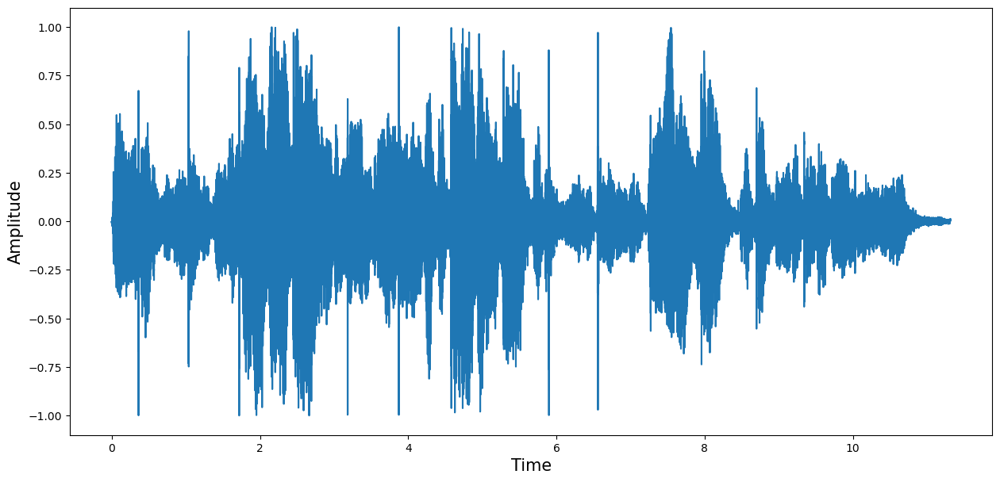

In [24]:
file_audioG=('Grave.wav') #Ruta del archivo con la señal
fsG, xG=read(file_audioG)  #Cargar el archivo
fsG=2*fsG
x_flatG = np.frombuffer(xG, dtype=np.int16)
x_flatG=x_flatG/float(max(abs(x_flatG)))  #Escala de amplitud de la señal
t=np.arange(0,float(len(x_flatG))/fsG, 1/fsG)  #vector de tiempo
x_flatG=x_flatG-np.mean(x_flatG)

plt.figure(figsize=(15,7))
plt.plot(t,x_flatG)  #graficacion
plt.xlabel('Time',fontsize=15)
plt.ylabel('Amplitude',fontsize=15)
plt.show()

Audio(x_flatG,rate=fsG)  #para escuchar la señal si se desea

La voz del primer audio se escucha en una tonalidad mas aguda que la del segundo,por tanto se esperaría que se encontrara en frecuencias mas altas, alrededor de entre 1000Hz-4000Hz mientras que el segundo audio se esperaría que se encontrara en un rango de frecuencias inferiores a los 1000Hz.

## b. El audio "AudioM.wav" corresponde a la superposición de los 2 audios anteriores. Se solicita graficarlo y graficar también en un subplot las respuestas en frecuencia de los 3 audios analizados.¿El espectro en frecuencias obtenido si es el esperado en cada caso?¿Cree usted que sería posible aislar las voces en el tercer audio mediante el uso de filros FIR?

C:\Users\JOHAN MORA\AppData\Local\Temp\ipykernel_6412\335858310.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fsM, xM=read(file_audio)  #Cargar el archivo


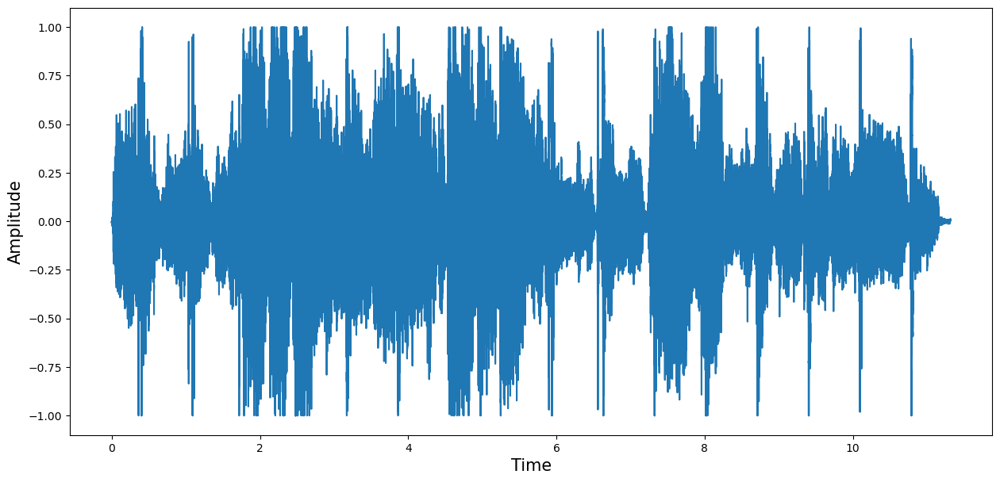

In [25]:
file_audio=('AudioM.wav') #Ruta del archivo con la señal
fsM, xM=read(file_audio)  #Cargar el archivo

fsM=2*fsM
x_flatM = np.frombuffer(xM, dtype=np.int16)

x_flatM=x_flatM/float(max(abs(x_flatM)))  #Escala de amplitud de la señal
t=np.arange(0,float(len(x_flatM))/fsM, 1/fsM)  #vector de tiempo
x_flatM=x_flatM-np.mean(x_flatM)

plt.figure(figsize=(15,7))
plt.plot(t,x_flatM)  #graficacion
plt.xlabel('Time',fontsize=15)
plt.ylabel('Amplitude',fontsize=15)
plt.show()
Audio(x_flatM,rate=fs)  #para escuchar la señal si se desea

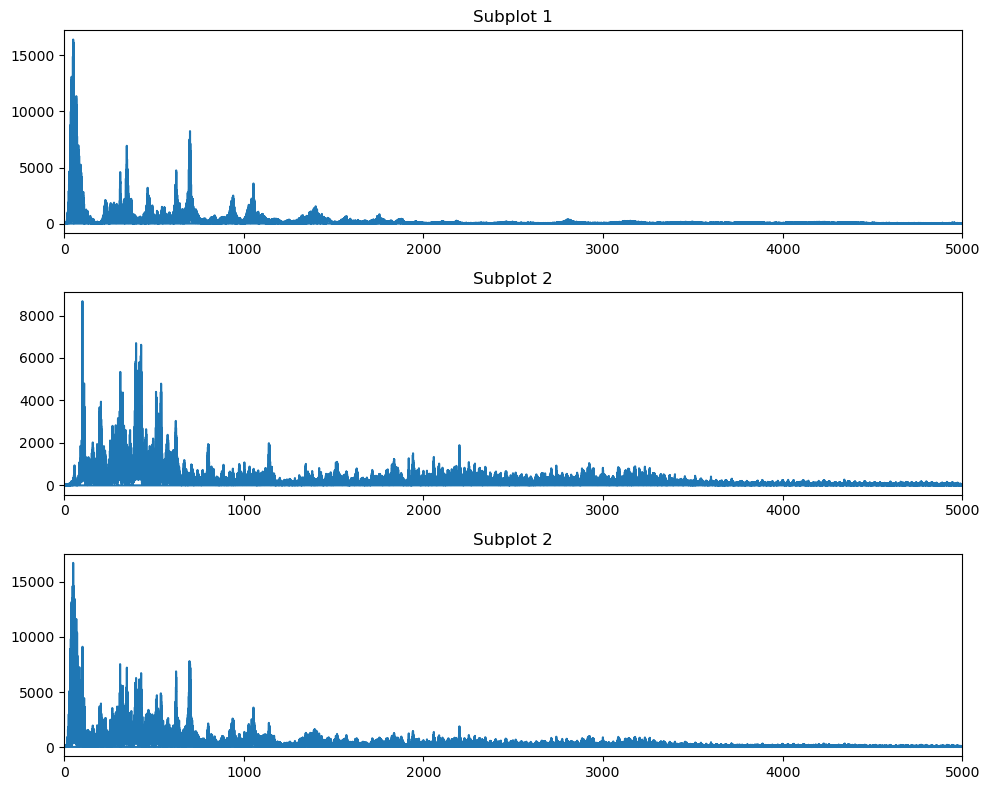

In [26]:
fmin=0
fmax=5000
# Cálculo de la transformada de Fourier
transformadaA = fft(x_flatA)
frecuenciasA = fftfreq(len(x_flatA), 1 / fsA)

transformadaG = fft(x_flatG)
frecuenciasG= fftfreq(len(x_flatG), 1 / fsA)

transformadaM = fft(x_flatM)
frecuenciasM = fftfreq(len(x_flatM), 1 / fsA)

# Crear la figura y los subplots
fig, axs = plt.subplots(3, figsize=(10, 8))

# Subplot 1
axs[0].plot(frecuenciasA, np.abs(transformadaA))
axs[0].set_title('Subplot 1')
axs[0].set_xlim(fmin, fmax)  # Establecer los límites del eje x

# Subplot 2
axs[1].plot(frecuenciasG, np.abs(transformadaG))
axs[1].set_title('Subplot 2')
axs[1].set_xlim(fmin, fmax)  # Establecer los límites del eje x

axs[2].plot(frecuenciasM, np.abs(transformadaM))
axs[2].set_title('Subplot 2')
axs[2].set_xlim(fmin, fmax)  # Establecer los límites del eje 

# Ajustar el espacio entre los subplots
plt.tight_layout()

# Mostrar el gráfico
plt.show()


##### Para el audio con la voz mas aguda el espectro difiere del esperado, esto porque la mayor parte de la señal se encuentra en un rango de frecuencias inferior a 1000 Hz, por su parte se puede observar como para el segundo audio el rango de frecuencias se extiende hasta los 4000 Hz, lo cual tampoco era esperado, por ultimo, se aprecia como el espectro de la señal superpuesta corresponde  la suma del espectro de las señales individuales.
##### Con el uso de filtros FIR se podrían atenuar las bandas de frecuencias correspondientes a una de las voces y con esto quizá sería posible atenuarla considerablemente con respecto a la otra voz

## c. Diseñar un sistema de filtros que permita aislar o en su defecto atenuar una de las voces del audio "AudioM.wav". ¿De que manera pretende abordar este reto?¿Será posible lograrlo unicamente con la implementación de filtros FIR?

##### Inicialmente es posible identificar los picos de frecuencia mas relevantes de la señal que se pretende atenuar, en este caso será la señal "Agudo.wav"

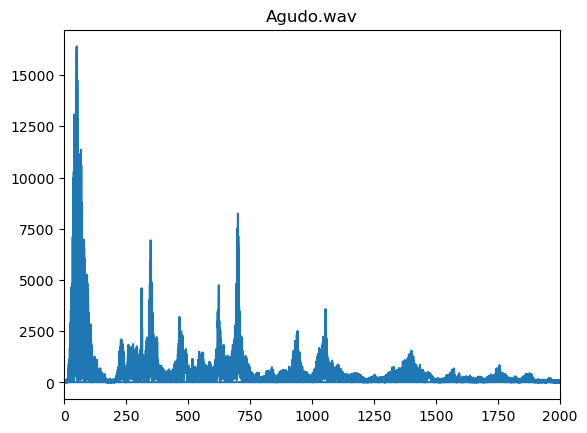

In [27]:
fmin=0
fmax=2000
plt.plot(frecuenciasA, np.abs(transformadaA))
plt.title('Agudo.wav')
plt.xlim(fmin, fmax)  # Establecer los límites del eje x
plt.show()

##### Del gráfico se pueden apreciar las bandas de frecuencia mas relevantes de "Agudo.wav":
###### 0Hz-150Hz
###### 210Hz-380Hz
###### 450Hz-500Hz
###### 610Hz-750Hz
###### 1000Hz-1150Hz
###### 1300Hz-1500Hz
##### Se diseñara entonces un filtro que atenúe cada una de estas bandas para comprobar si es realmente posible el desafío propuesto.

In [28]:
nyq_rate = fs / 2.0
roll_off = 50
width = roll_off/nyq_rate
ripple_db = 60.0 #The desired attenuation in the stop band, in dB.
num_taps,_= kaiserord(ripple_db, width) # Compute the order and Kaiser parameter for the FIR filter.

fc=150/nyq_rate
taps = firwin(num_taps, fc, pass_zero="highpass")
w, h = signal.freqz(taps, [1], worN=2000)

br1=[210/nyq_rate,380/nyq_rate]
taps1 = firwin(num_taps, br1, pass_zero="bandstop")
w1, h1 = signal.freqz(taps1, [1], worN=2000)

br2=[450/nyq_rate,500/nyq_rate]
taps2 = firwin(num_taps, br2, pass_zero="bandstop")
w2, h2 = signal.freqz(taps2, [1], worN=2000)

br3=[610/nyq_rate,750/nyq_rate]
taps3 = firwin(num_taps, br3, pass_zero="bandstop")
w3, h3 = signal.freqz(taps3, [1], worN=2000)

br4=[1000/nyq_rate,1150/nyq_rate]
taps4 = firwin(num_taps, br4, pass_zero="bandstop")
w4, h4 = signal.freqz(taps4, [1], worN=2000)

br5=[1300/nyq_rate,1500/nyq_rate]
taps5 = firwin(num_taps, br5, pass_zero="bandstop")
w5, h5 = signal.freqz(taps5, [1], worN=2000)

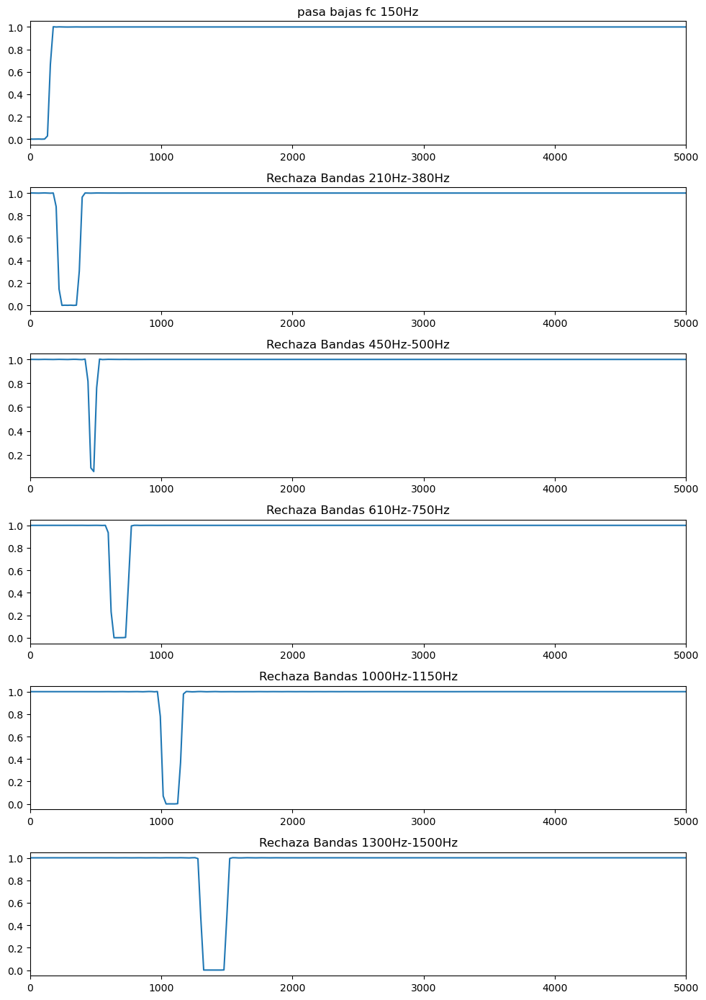

In [29]:
fmin=0
fmax=5000

# Crear la figura y los subplots
fig, axs = plt.subplots(6, figsize=(10, 14))

axs[0].plot(nyq_rate*w/np.pi, np.abs(h))
axs[0].set_title('pasa bajas fc 150Hz')
axs[0].set_xlim(fmin, fmax)  # Establecer los límites del eje x

axs[1].plot(nyq_rate*w1/np.pi, np.abs(h1))
axs[1].set_title('Rechaza Bandas 210Hz-380Hz')
axs[1].set_xlim(fmin, fmax)  # Establecer los límites del eje x

axs[2].plot(nyq_rate*w2/np.pi, np.abs(h2))
axs[2].set_title('Rechaza Bandas 450Hz-500Hz')
axs[2].set_xlim(fmin, fmax)  # Establecer los límites del eje x 

axs[3].plot(nyq_rate*w3/np.pi, np.abs(h3))
axs[3].set_title('Rechaza Bandas 610Hz-750Hz')
axs[3].set_xlim(fmin, fmax)  # Establecer los límites del eje x

axs[4].plot(nyq_rate*w4/np.pi, np.abs(h4))
axs[4].set_title('Rechaza Bandas 1000Hz-1150Hz')
axs[4].set_xlim(fmin, fmax)  # Establecer los límites del eje x

axs[5].plot(nyq_rate*w5/np.pi, np.abs(h5))
axs[5].set_title('Rechaza Bandas 1300Hz-1500Hz')
axs[5].set_xlim(fmin, fmax)  # Establecer los límites del eje x

# Ajustar el espacio entre los subplots
plt.tight_layout()

# Mostrar el gráfico
plt.show()

In [30]:
filtered_x = lfilter(taps, 1.0, x_flatM)
filtered_x2 = lfilter(taps1, 1.0, filtered_x)
filtered_x3 = lfilter(taps2, 1.0, filtered_x2)
filtered_x4 = lfilter(taps3, 1.0, filtered_x3)
filtered_x5 = lfilter(taps4, 1.0, filtered_x4)
filtered_x6 = lfilter(taps5, 1.0, filtered_x5)

(0.0, 5000.0)

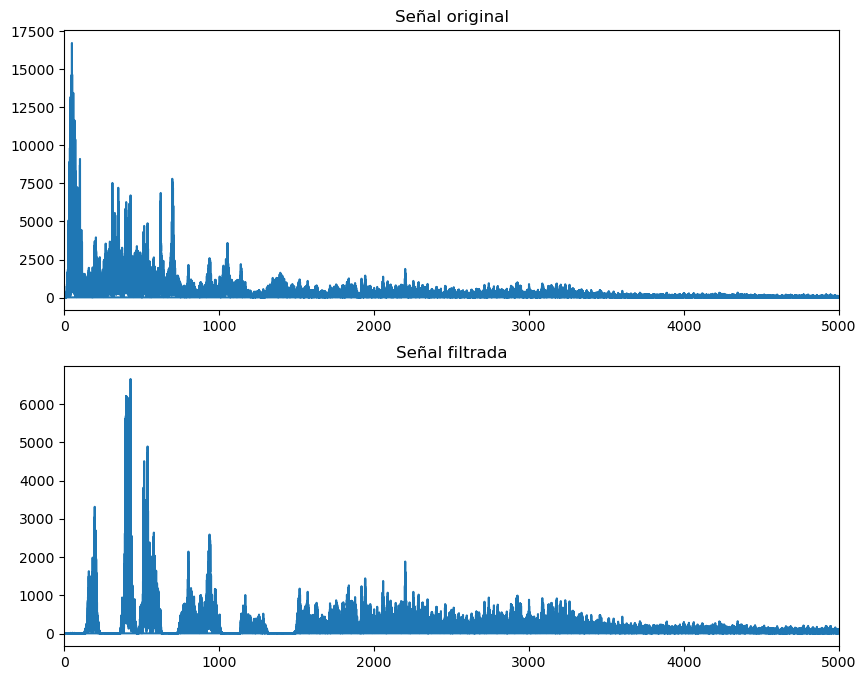

In [31]:
fmin=0
fmax=5000
# Cálculo de la transformada de Fourier
transformadaF = fft(filtered_x6)
frecuenciasF = fftfreq(len(filtered_x6), 1 / fsA)

# Crear la figura y los subplots
fig, axs = plt.subplots(2, figsize=(10, 8))

# Subplot 1
axs[0].plot(frecuenciasM, np.abs(transformadaM))
axs[0].set_title('Señal original')
axs[0].set_xlim(fmin, fmax)  # Establecer los límites del eje x

# Subplot 2
axs[1].plot(frecuenciasF, np.abs(transformadaF))
axs[1].set_title('Señal filtrada')
axs[1].set_xlim(fmin, fmax)  # Establecer los límites del eje x

In [32]:
Audio(filtered_x6,rate=fs)  #para escuchar la señal si se desea

##### Luego de usar una serie de filtros en cascada, tan solo se logró atenuar un poco la voz mas aguda, identificando y atenuando los picos maximos de frecuencia, pues para este tipo de procesamiento de señales no son suficientes tan solo los filtros FIR.

# Conclusiones
#### -La separación de fuentes de audio en un solo archivo puede ser un desafío complejo y no siempre se logra de manera precisa y satisfactoria, los filtros FIR se utilizan comúnmente en el procesamiento de señales de audio para realizar filtrado y manipulación de las características de la señal. Sin embargo, separar eficazmente dos voces superpuestas en un solo audio es un problema más complejo, se necesita de técnicas avanzadas de procesamiento de señales que pueden aplicarse en combinación con filtros FIR u otros métodos de filtrado para ayudar a separar y mejorar la calidad de las voces en un audio.

#### - El enventanado rectangular si bien es el mas simple, puede introducir fugas de frecuencia y lóbulos laterales en la respuesta en frecuencia, mientras que el enventanado de Hamming proporciona una mejor atenuación de lóbulos laterales y una respuesta en frecuencia más suave. La elección entre estos dos enventanados depende de los requisitos específicos de la aplicación y del equilibrio entre la atenuación de los lóbulos laterales y la resolución en frecuencia deseada.

#### -Al utilizar un enventanado específico en filtros FIR, es importante tener en cuenta los requisitos del filtro, como la respuesta en frecuencia deseada y las características específicas que se buscan, como resolución en frecuencia, ancho de banda de transición y atenuación de los lóbulos laterales. Además, se debe considerar el tamaño de la ventana, que afecta la resolución y la complejidad computacional. Ajustar los parámetros de la ventana puede permitir un control más preciso del rendimiento del filtro. También es esencial considerar las limitaciones de implementación práctica, como la precisión numérica y los recursos computacionales disponibles.
#### - Aunque existen diferentes tipos de filtros con características y aplicaciones específicas, la versatilidad de la transformación de frecuencia permite obtener cualquier tipo de filtro a partir de un filtro pasa bajos mediante técnicas adecuadas de manipulación de la respuesta en frecuencia. Esto brinda flexibilidad en el diseño y la implementación de filtros, simplificando la necesidad de disponer de diversos tipos de filtros específicos.